### Task 1.1 Define a problem

**Define an image classification problem that may help people better recycle, particularly by reducing contamination.**


The Problem we are going to address here is to reduce waste contamination, by classifing diffrent garbage wastes into diffrent classes. In order to diffrentiate the waste into recycle and non-recycle waste. First we need to identify the waste for diffrentiating the items into recycle and non recycle waste. So in this Solution we are going to perform image classification model where we will classify the six Primary Waste items. like Carbaord, plastic, paper, trash , metal and glass. 

**Describe the desired inputs and outputs, including the target classes.**

The inputs will be images and outputs 4 class classification , the Target classes are identified as "Glass, cardboard, paper,trash,metal and plastic"

### Task 1.2 Make a plan

**What dataset can you use to develop a deep learning solution?**

For this solution we are going to use "Garbage Classification dataset" from kaggle . Kaggle is Opensource Data and soultion Sharing platform. The data set contains arround 2527 Total  Garbage Classification Dataset contains 6 classifications: cardboard (393), glass (491), metal (400), paper(584), plastic (472) and trash(127).

**How many images do you need? How many for training? How many for testing?**

Since 2k images is below the nominal value for image classification in, i have decided to whole images for building model. 

But however i will be using 2276 images for Training so that the model can learn best knowledge of the classes with number training sets and 251 images for Testing. 

**Do you need to label the images yourself?**

Although the the labels are availble along with dataset, we are going to create labels for our training and test set becuase we are going to split the data randomly to get even distribution of classes in train and Test sets.


**How do you determine if your model is good enough?**

The model evaluation will be determined using Classification matrix and also the loss and accuracy of model will be plotted in graph to show model perfomance.


### Task 1.3 Implement a solution

**Collect relevant data.**




In [1]:
! pip install kaggle

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
! mkdir ~/.kaggle

In [3]:
! cp sample_data/kaggle.json ~/.kaggle/

In [4]:
! chmod 600 ~/.kaggle/kaggle.json

In [5]:
! kaggle datasets download asdasdasasdas/garbage-classification

 89% 73.0M/82.0M [00:03<00:00, 32.4MB/s]
100% 82.0M/82.0M [00:03<00:00, 28.1MB/s]


In [6]:
! unzip garbage-classification.zip

Streaming output truncated to the last 5000 lines.
  inflating: Garbage classification/Garbage classification/cardboard/cardboard152.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/cardboard153.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/cardboard154.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/cardboard155.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/cardboard156.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/cardboard157.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/cardboard158.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/cardboard159.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/cardboard16.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/cardboard160.jpg  
  inflating: Garbage classification/Garbage classification/cardboard/c

**Develop a deep learning model.**



In [7]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow import keras
import numpy as np
import matplotlib.pyplot as plt
from keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array, array_to_img
from keras.layers import Conv2D, Flatten, MaxPooling2D, Dense
from keras.models import Sequential

import glob, os, random




base_path = '/content/Garbage classification/Garbage classification'

img_list = glob.glob(os.path.join(base_path, '*/*.jpg'))

print(len(img_list))

2527


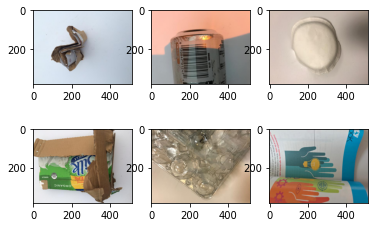

In [8]:
#Previewing the images 

from PIL import Image
for i, img_path in enumerate(random.sample(img_list, 6)):
    img = load_img(img_path)
    img = img_to_array(img, dtype=np.uint8)

    plt.subplot(2, 3, i+1)
    plt.imshow(img.squeeze())


In [9]:
#Preparing Test, Train and Validation

train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.1,
    zoom_range=0.1,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    vertical_flip=True,
    validation_split=0.1
)

test_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.1
)

train_generator = train_datagen.flow_from_directory(
    base_path,
    target_size=(300, 300),
    batch_size=16,
    class_mode='categorical',
    subset='training',
    seed=0
)

validation_generator = test_datagen.flow_from_directory(
    base_path,
    target_size=(300, 300),
    batch_size=16,
    class_mode='categorical',
    subset='validation',
    seed=0
)

labels = (train_generator.class_indices)
labels = dict((v,k) for k,v in labels.items())

print(labels)


Found 2276 images belonging to 6 classes.
Found 251 images belonging to 6 classes.
{0: 'cardboard', 1: 'glass', 2: 'metal', 3: 'paper', 4: 'plastic', 5: 'trash'}


In [58]:
#Now Lets build our model 

model = Sequential([
    Conv2D(filters=32, kernel_size=3, padding='same', activation='relu', input_shape=(300, 300, 3)),
    MaxPooling2D(pool_size=2),

    Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(pool_size=2),

    Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(pool_size=2),

    Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(pool_size=2),

    Flatten(),

    Dense(64, activation='relu'),

    Dense(6, activation='softmax')
])

model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])

model.summary()



Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 300, 300, 32)      896       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 150, 150, 32)     0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 150, 150, 64)      18496     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 75, 75, 64)       0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 75, 75, 32)        18464     
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 37, 37, 32)      

In [59]:
callback = tf.keras.callbacks.EarlyStopping(patience=4, restore_best_weights=True)
history = model.fit_generator(train_generator, epochs=50,validation_data=validation_generator,callbacks=[callback])

Epoch 1/50


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  


158/158 [==============================] - 13s 81ms/step - loss: 3.0364 - acc: 0.2608 - val_loss: 1.7681 - val_acc: 0.1952
Epoch 2/50
158/158 [==============================] - 13s 80ms/step - loss: 1.5692 - acc: 0.3617 - val_loss: 1.7599 - val_acc: 0.1912
Epoch 3/50
158/158 [==============================] - 13s 80ms/step - loss: 1.2776 - acc: 0.5030 - val_loss: 1.7582 - val_acc: 0.1912
Epoch 4/50
158/158 [==============================] - 13s 80ms/step - loss: 1.0343 - acc: 0.6003 - val_loss: 1.7506 - val_acc: 0.1992
Epoch 5/50
158/158 [==============================] - 13s 79ms/step - loss: 0.8178 - acc: 0.6901 - val_loss: 1.7393 - val_acc: 0.2908
Epoch 6/50
158/158 [==============================] - 13s 79ms/step - loss: 0.5879 - acc: 0.7859 - val_loss: 1.7370 - val_acc: 0.2789
Epoch 7/50
158/158 [==============================] - 13s 79ms/step - loss: 0.4811 - acc: 0.8330 - val_loss: 1.7339 - val_acc: 0.2311
Epoch 8/50
158/158 [==============================] - 13s 79ms/step - los

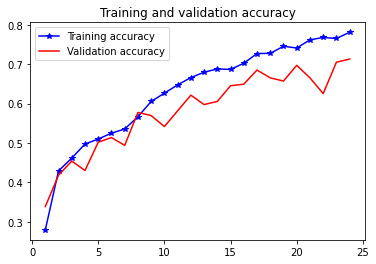

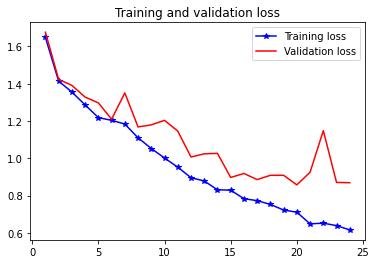

In [12]:
train_acc = history.history['acc']
val_acc = history.history['val_acc']
train_loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(train_acc) + 1)

plt.plot(epochs, train_acc, 'b*-', label = 'Training accuracy')
plt.plot(epochs, val_acc, 'r', label = 'Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, train_loss, 'b*-', label = 'Training loss')
plt.plot(epochs, val_loss, 'r', label = 'Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

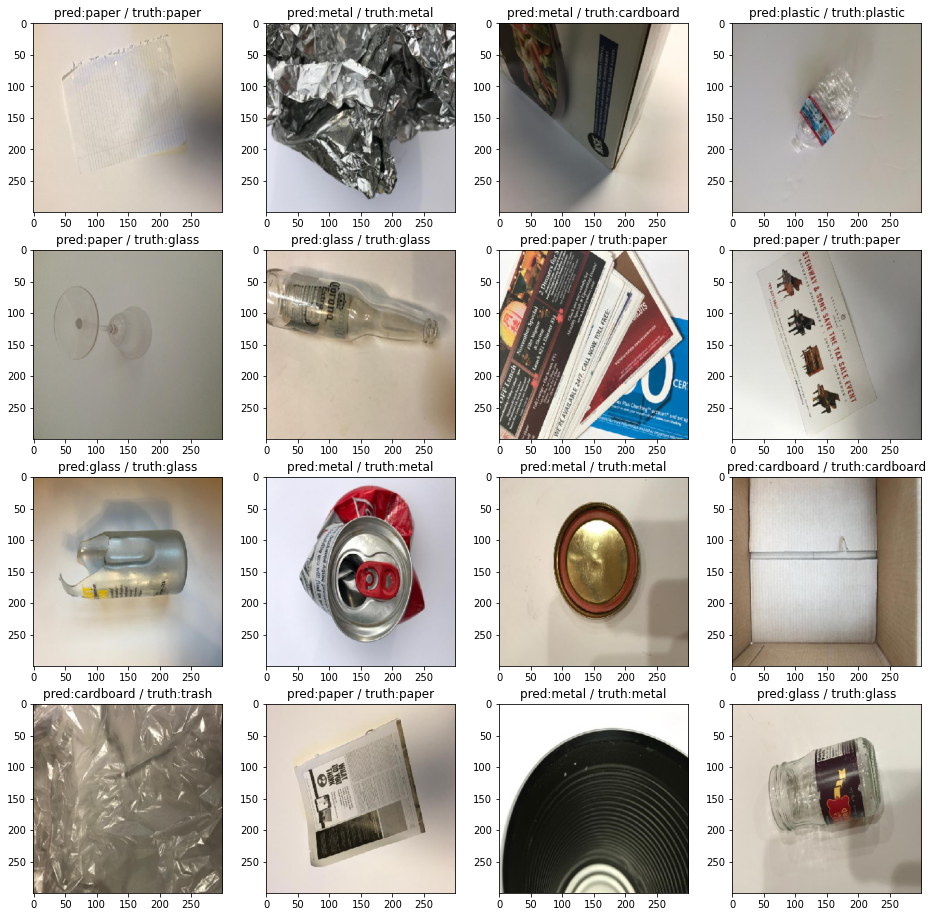

In [13]:
test_x, test_y = validation_generator.__getitem__(1)

preds = model.predict(test_x)

plt.figure(figsize=(16, 16))
for i in range(16):
    plt.subplot(4, 4, i+1)
    plt.title('pred:%s / truth:%s' % (labels[np.argmax(preds[i])], labels[np.argmax(test_y[i])]))
    plt.imshow(test_x[i])


In [14]:
print("-- Evaluate --")
scores = model.evaluate_generator(validation_generator, steps=5)
print("%s: %.2f%%" %(model.metrics_names[1], scores[1]*100))

-- Evaluate --


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  


acc: 77.50%


In [15]:
from sklearn.metrics import classification_report
test_true = np.argmax(test_y, axis=1)
test_pred = np.argmax(preds, axis=1)
print(classification_report(test_true, test_pred))

              precision    recall  f1-score   support

           0       0.50      0.50      0.50         2
           1       1.00      0.75      0.86         4
           2       0.80      1.00      0.89         4
           3       0.80      1.00      0.89         4
           4       1.00      1.00      1.00         1
           5       0.00      0.00      0.00         1

    accuracy                           0.81        16
   macro avg       0.68      0.71      0.69        16
weighted avg       0.77      0.81      0.78        16



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [16]:
from sklearn.metrics import confusion_matrix

predictions_one_hot = model.predict(test_x)
cm = confusion_matrix(test_true, test_pred)
print(cm)

[[1 0 1 0 0 0]
 [0 3 0 1 0 0]
 [0 0 4 0 0 0]
 [0 0 0 4 0 0]
 [0 0 0 0 1 0]
 [1 0 0 0 0 0]]


In [17]:
FP = cm.sum(axis=0) - np.diag(cm)  
FN = cm.sum(axis=1) - np.diag(cm)
TP = np.diag(cm)
TN = cm.sum() - (FP + FN + TP)


# Individual accuracy for class labels
print ("Cardboard Glass Metal Paper Plastic Trash")
ACC = (TP+TN)/(TP+FP+FN+TN)
print (ACC)

Cardboard Glass Metal Paper Plastic Trash
[0.875  0.9375 0.9375 0.9375 1.     0.9375]


**Report the model performance against the success criteria that you define.**

From the above observation we can see the model has perfomed pretty well with accuracy arround 67%. The Learning curves also showes the model has trained well with validation and Training curves almost converging on both accuracy and loss graphs.

## **Task 2 (C Task) Analyse and improve the model**

### Task 2.1 Build an input pipeline for data augmentation


**Build a data preprocessing pipeline to perform data augmentation. (You may use Keras ImageDataGenerator or write your own transformations.)**

In the above model you would have noticed that i have generated the images in preprocessing section using Imagedatagenerator using various transformation. So we will use the same transformation and observe performance using tensorboard.

In [18]:
#Preparing Test, Train and Validation

train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.1,
    zoom_range=0.1,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    vertical_flip=True,
    validation_split=0.1
)

test_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.1
)

train_generator = train_datagen.flow_from_directory(
    base_path,
    target_size=(300, 300),
    batch_size=16,
    class_mode='categorical',
    subset='training',
    seed=0
)

validation_generator = test_datagen.flow_from_directory(
    base_path,
    target_size=(300, 300),
    batch_size=16,
    class_mode='categorical',
    subset='validation',
    seed=0
)

labels = (train_generator.class_indices)
labels = dict((v,k) for k,v in labels.items())

print(labels)


Found 2276 images belonging to 6 classes.
Found 251 images belonging to 6 classes.
{0: 'cardboard', 1: 'glass', 2: 'metal', 3: 'paper', 4: 'plastic', 5: 'trash'}


In [19]:
!pip uninstall -q tensorboard tb-nightly
!pip install -q tb-nightly tensorboard_plugin_profile
!pip install -U tensorboard_plugin_profile

Proceed (y/n)? y
     |████████████████████████████████| 5.9 MB 28.5 MB/s 
     |████████████████████████████████| 5.3 MB 52.3 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [20]:
!rm -rf ./logs/
from datetime import datetime
import os

logs = 'logs/' + datetime.now().strftime("%Y%m%d - %H%M%S")
CB_TensorBoard = tf.keras.callbacks.TensorBoard(log_dir= logs,profile_batch = '10,15',histogram_freq  = 1,update_freq="epoch")


model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])

In [21]:
history = model.fit_generator(train_generator, epochs=50,validation_data=validation_generator,callbacks=[CB_TensorBoard])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  """Entry point for launching an IPython kernel.


Epoch 1/50
143/143 [==============================] - 56s 387ms/step - loss: 0.6787 - acc: 0.7597 - val_loss: 0.8905 - val_acc: 0.6733
Epoch 2/50
143/143 [==============================] - 46s 324ms/step - loss: 0.6428 - acc: 0.7667 - val_loss: 0.9933 - val_acc: 0.6414
Epoch 3/50
143/143 [==============================] - 46s 319ms/step - loss: 0.6525 - acc: 0.7601 - val_loss: 0.9647 - val_acc: 0.6853
Epoch 4/50
143/143 [==============================] - 45s 317ms/step - loss: 0.6225 - acc: 0.7838 - val_loss: 0.8050 - val_acc: 0.7251
Epoch 5/50
143/143 [==============================] - 46s 320ms/step - loss: 0.6113 - acc: 0.7830 - val_loss: 0.8862 - val_acc: 0.6892
Epoch 6/50
143/143 [==============================] - 46s 321ms/step - loss: 0.5966 - acc: 0.7781 - val_loss: 0.9576 - val_acc: 0.6773
Epoch 7/50
143/143 [==============================] - 46s 324ms/step - loss: 0.5723 - acc: 0.7979 - val_loss: 0.8316 - val_acc: 0.7052
Epoch 8/50
143/143 [==============================] - 4

In [22]:
%load_ext tensorboard
%tensorboard --logdir=logs

<IPython.core.display.Javascript object>

From the above the Perfomance Summary in Profile Tab of tensorboard we can see that input time has conumed more time compared to all other operation. The Possible action we could take is reduce the image data to feed in as input but that would evatuallly would reduce the preformance of mode. or we can test the perfomance summary with or with out data augmentaion.

### Task 2.2 Compare the performance under equal training time

**You may notice that with your pipeline, the model performance improves, but at the cost of a longer training time per epoch. Is the additional training time well spent? Compare the dynamic of model performance (e.g., classification accuracy on the test data) with and without data augmentation, when equal training time is spent in the two scenarios.**

The above results in Task 2.1 show observation for data with augmentaion in Preprocessing pipline, now lets try without data augmentaion.

In [23]:
#Preparing Test, Train and Validation

train_datagen = ImageDataGenerator()

test_datagen = ImageDataGenerator(rescale=1./255,
    validation_split=0.1)

train_generator = train_datagen.flow_from_directory(
    base_path,
    target_size=(300, 300),
    batch_size=16,
    class_mode='categorical',
    subset='training',
    seed=0
)

validation_generator = test_datagen.flow_from_directory(
    base_path,
    target_size=(300, 300),
    batch_size=16,
    class_mode='categorical',
    subset='validation',
    seed=0
)

labels = (train_generator.class_indices)
labels = dict((v,k) for k,v in labels.items())

print(labels)


Found 2527 images belonging to 6 classes.
Found 251 images belonging to 6 classes.
{0: 'cardboard', 1: 'glass', 2: 'metal', 3: 'paper', 4: 'plastic', 5: 'trash'}


In [24]:
!rm -rf ./logs/
from datetime import datetime
import os

logs = 'logs/' + datetime.now().strftime("%Y%m%d - %H%M%S")
CB_TensorBoard = tf.keras.callbacks.TensorBoard(log_dir= logs,profile_batch = '10,15',histogram_freq  = 1,update_freq="epoch")


model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])

In [25]:
history = model.fit_generator(train_generator, epochs=50,validation_data=validation_generator,callbacks=[CB_TensorBoard])

Epoch 1/50


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  """Entry point for launching an IPython kernel.


158/158 [==============================] - 23s 143ms/step - loss: 90.7491 - acc: 0.6510 - val_loss: 3.6300 - val_acc: 0.2709
Epoch 2/50
158/158 [==============================] - 13s 82ms/step - loss: 14.5678 - acc: 0.7040 - val_loss: 4.1542 - val_acc: 0.2470
Epoch 3/50
158/158 [==============================] - 13s 83ms/step - loss: 7.1742 - acc: 0.7408 - val_loss: 4.3284 - val_acc: 0.1793
Epoch 4/50
158/158 [==============================] - 13s 82ms/step - loss: 3.9038 - acc: 0.7792 - val_loss: 4.4733 - val_acc: 0.1753
Epoch 5/50
158/158 [==============================] - 13s 81ms/step - loss: 2.3807 - acc: 0.8188 - val_loss: 4.4485 - val_acc: 0.1673
Epoch 6/50
158/158 [==============================] - 13s 83ms/step - loss: 1.4501 - acc: 0.8639 - val_loss: 4.2975 - val_acc: 0.1992
Epoch 7/50
158/158 [==============================] - 13s 81ms/step - loss: 1.0659 - acc: 0.8821 - val_loss: 4.1996 - val_acc: 0.2032
Epoch 8/50
158/158 [==============================] - 14s 90ms/step - 

In [26]:
%load_ext tensorboard
%tensorboard --logdir=logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1538), started 0:11:12 ago. (Use '!kill 1538' to kill it.)

<IPython.core.display.Javascript object>

### Task 2.3 Identifying model strength and weakness

**Identify images that are incorrectly classified by your model. Do they share something in common? How do you plan to improve the model's performance on those images?** 



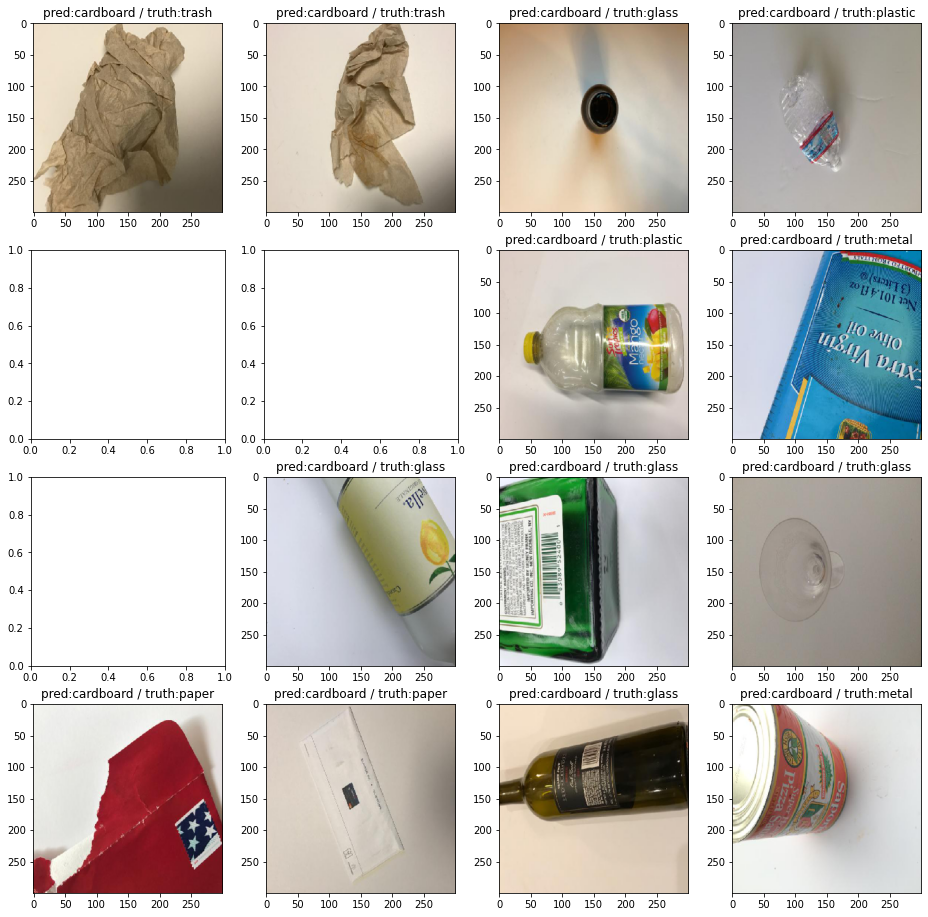

In [27]:
test_x, test_y = validation_generator.__getitem__(1)

prediction = model.predict(test_x)

plt.figure(figsize=(16, 16))
for i in range(16):
  plt.subplot(4, 4, i+1)
  if np.argmax(prediction[i]) != np.argmax(test_y[i]):
    plt.title('pred:%s / truth:%s' % (labels[np.argmax(prediction[i])], labels[np.argmax(test_y[i])]))
    plt.imshow(test_x[i])






From the above images we can see the miscalssified images, with thier true Predictive class and truth class. The one common thing we can see in this images is not fully covered images are seen in diffrent angle and objects are not fully covered, as most of our images in training images not cropped and objects are fully seen.  This may be one of the reason that these images has been misclassified.

## **Task 3 (D Task) Improve model generalisability across domains**

**So far, you have used training and test images from the same source (via random data split). Now collect new test images from a different source. For example, you may take some photos yourself if you used downloaded images before.
Otherwise, you may take new photos using a different mobile phone or against a different background.**

Show sample images from the original test data and the newly collected test data. In what ways are they different?

Feed the new test data into your model. Report the performance change.

Improve your model so that it generalises better on unseen test images.


In [60]:




import cv2
from PIL import Image, ImageOps
import numpy as np

def import_and_predict(image_data, model):
  size = (300,300)    
  #image = ImageOps.fit(image_data, size, Image.ANTIALIAS)
  #image1 = np.asarray(image_data)
  #img2 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)
  img_resize = (cv2.resize(image_data, dsize=(300, 300),    interpolation=cv2.INTER_CUBIC))/255.
  img_reshape = img_resize[np.newaxis,...]
  prediction = model.predict(img_reshape)
        
  return prediction

In [29]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


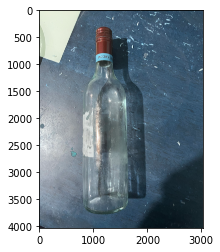

In [63]:
from matplotlib import pyplot as plt
img= cv2.imread('/content/gdrive/MyDrive/glass.jpg')

plt.imshow(img)


In [64]:
predict_test = import_and_predict(img,model)
print(predict_test)
print(np.argmax(predict_test))

labels

[[0.1491692  0.20592603 0.16559957 0.16978124 0.17849547 0.1310285 ]]
1


{0: 'cardboard', 1: 'glass', 2: 'metal', 3: 'paper', 4: 'plastic', 5: 'trash'}

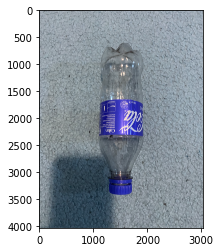

In [79]:
from matplotlib import pyplot as plt
img= cv2.imread('/content/gdrive/MyDrive/plastic.jpg')

plt.imshow(img)


In [78]:

predict_test = import_and_predict(img,model)
print(predict_test)
print(np.argmax(predict_test))

labels

[[0.16917731 0.18249026 0.14124504 0.17772408 0.19261447 0.13674879]]
4


{0: 'cardboard', 1: 'glass', 2: 'metal', 3: 'paper', 4: 'plastic', 5: 'trash'}

We can see that my Test image taken from my phone which was uploaded through the google drive is now correctly classified into glass and plastic



## **Task 4 (HD Task) Build a workable prototype**

Build a web/mobile app that people from your city council can use to determine what to recycle. Test your prototype with the target users and report their feedback.

Upload your code into a GitHub repository.

Create a short video presentation about your product.

In [92]:
tf.keras.models.save_model(model,'my_model1.hdf5')

Once the model is exported , we will create new .py File know as "Webapp.py" which contains the code for running and deploying code in Web application.

After compiling we will run the "Webapp.py" file in comman prompt which will open local host URL , where we can test our model in Web Application